# **Importing the required libraries**

In [1]:
#!pip install opencv-python


In [2]:
import os
import shutil
import cv2
import sys
import random
import glob
import numpy as np
import warnings
import time
import datetime as dt
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
plt.style.use("seaborn")

%matplotlib inline
 
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, Callback
from tensorflow.keras.utils import plot_model

In [3]:
sys.path.append('/kaggle/input/libraryvideogenerator/')
from generator import VideoFrameGenerator

In [4]:
warnings.filterwarnings('ignore')

#look documentation : https://www.kaggle.com/docs/tpu
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    print("TPU")
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    print("GPU")
    strategy = tf.distribute.get_strategy() 

print("REPLICAS: ", strategy.num_replicas_in_sync)

GPU
REPLICAS:  1


# **Visualize the Data**

In [5]:
from IPython.display import HTML
from base64 import b64encode

# To Show a Video in Notebook
def Play_Video(filepath):
    html = ''
    video = open(filepath,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

In [6]:
# Classes Directories
NonViolnceVideos_Dir = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/NonViolence/"
ViolnceVideos_Dir = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/Violence/"

# Retrieve the list of all the video files present in the Class Directory.
NonViolence_files_names_list = os.listdir(NonViolnceVideos_Dir)
Violence_files_names_list = os.listdir(ViolnceVideos_Dir)

# Randomly select a video file from the Classes Directory.
Random_NonViolence_Video = random.choice(NonViolence_files_names_list)
Random_Violence_Video = random.choice(Violence_files_names_list)

**Play Random Non Violence Video**

In [7]:
Play_Video(f"{NonViolnceVideos_Dir}/{Random_NonViolence_Video}")

**Play Random Violence Video**

In [8]:
Play_Video(f"{ViolnceVideos_Dir}/{Random_Violence_Video}")

# **Creating the Data**

In [9]:
def get_class(folder):
    """ Retrieve the name of the class given a filename.

    Args:
    fname: folder of the dataset.

    Returns:
    Class that the file belongs to.
    """
    #'../input/real-life-violence-situations-dataset/Real Life Violence Dataset/*
    files = [i.split(os.path.sep)[-1] for i in glob.glob(folder)]
    files.sort()
    print(
        "Total class : %d"
        % (len(files))
    )
    return files

In [10]:
glob_pattern='../input/real-life-violence-situations-dataset/Real Life Violence Dataset/{classname}/*.mp4'
DATASET_DIR = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/*"

In [11]:
CLASSES = get_class(DATASET_DIR)

Total class : 2


In [12]:
# Specify the height and width to which each video frame will be resized in our dataset.
#224 x 224 for mobilnet
IMAGE_HEIGHT , IMAGE_WIDTH = 224, 224
SIZE = (IMAGE_HEIGHT , IMAGE_WIDTH)
# Specify the number of frames of a video that will be fed to the model as one sequence.
Frame = 20
#Batch size
BS = 13
#Seed 
SEED = 13
#Number of epochs
EPOCHS = 20

#BUFFER_SIZE = 1024

In [13]:
#pip install keras-video-generators
#import keras_video #keras_video.VideoFrameGenerator

Pour trouver les fichier si keras_video veut pas s'import

VideoFrameGenerator = generator.VideoFrameGenerator

OpticalFlowGenerator = flow.OpticalFlowGenerator

SlidingFrameGenerator = sliding.SlidingFrameGenerator

**for mullti stream dont use shuffle**

In [14]:
preprocess_fun = tf.keras.applications.densenet.preprocess_input

#rescale is already include in VideoFrameGenerator
datagen = keras.preprocessing.image.ImageDataGenerator(horizontal_flip=True,
                                   width_shift_range=0.1,
                                   height_shift_range=0.05,
                                   rescale = 1./255)#preprocessing_function=preprocess_fun

#for mullti stream dont use shuffle
train = VideoFrameGenerator(
    #classes=classes, 
    glob_pattern=glob_pattern,
    nb_frames=Frame,
    split_test=.3,
    split_val=.3, 
    shuffle=True,
    batch_size=BS,
    target_shape=SIZE,
    transformation=datagen,
    use_frame_cache=False,
    seed = SEED
)

valid = train.get_validation_generator()
test = train.get_test_generator()

class NonViolence, validation count: 285, test count: 199, train count: 467
class Violence, validation count: 300, test count: 210, train count: 490
Total data: 2 classes for 957 files for train
Total data: 2 classes for 585 files for validation
Total data: 2 classes for 409 files for test


In [15]:
def make_gen_callable(_gen):
    def gen():
        for x,y in _gen:
            yield x,y
    return gen

In [16]:
# Create the training set
output_signature = (tf.TensorSpec(shape = (BS, Frame, SIZE[0], SIZE[1], 3), dtype = tf.float32),
                    tf.TensorSpec(shape = (BS, 2), dtype = tf.int16))

train_ds = tf.data.Dataset.from_generator(make_gen_callable(train),output_signature = output_signature)
test_ds = tf.data.Dataset.from_generator(make_gen_callable(test),output_signature = output_signature)
valid_ds = tf.data.Dataset.from_generator(make_gen_callable(valid),output_signature = output_signature)

#attention RAM prefetch
AUTOTUNE = tf.data.experimental.AUTOTUNE
train_ds = train_ds.apply(tf.data.experimental.assert_cardinality(len(train.files)//BS)).prefetch(buffer_size=AUTOTUNE)#.batch(BS,num_parallel_calls=True).cache()
test_ds = test_ds.apply(tf.data.experimental.assert_cardinality(len(test.files)//BS)).prefetch(buffer_size=AUTOTUNE)#.batch(BS,num_parallel_calls=True).cache()
valid_ds = valid_ds.apply(tf.data.experimental.assert_cardinality(len(valid.files)//BS)).prefetch(buffer_size=AUTOTUNE)#.batch(BS,num_parallel_calls=True).cache()

steps_per_epoch = len(train.files)//BS

del train
del test
del valid

2023-01-08 14:19:10.617961: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-08 14:19:10.706626: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-08 14:19:10.707426: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-08 14:19:10.710342: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [17]:
# Print the shapes of the data (shape can be different : size in a batch)
#train_frames, train_labels = next(iter(train_ds))
#print(f'Shape of training set of frames: {train_frames.shape}')
#print(f'Shape of training labels: {train_labels.shape}')

#test_frames, test_labels = next(iter(test_ds))
#print(f'Shape of training set of frames: {test_frames.shape}')
#print(f'Shape of training labels: {test_labels.shape}')

#val_frames, val_labels = next(iter(valid_ds))
#print(f'Shape of validation set of frames: {val_frames.shape}')
#print(f'Shape of validation labels: {val_labels.shape}')

In [18]:
#show_sample(train)

# **Importing VGG19 and Fine-Tuning it.**

In [19]:
from tensorflow.keras.applications.vgg19 import VGG19

def VGG19_MODEL():

    vgg19_model = VGG19(include_top=False, weights='imagenet')

    vgg19_model.trainable=False

    for layer in vgg19_model.layers:
        layer.trainable=False

    #mobilenet.summary()
    return vgg19_model

# **Building The Model**

In [20]:
def create_model():
 
    model = Sequential()

    ########################################################################################################################
    cnn = Sequential()
    cnn.add(VGG19_MODEL())
    cnn.add(Flatten())
    
    #Specifying Input to match features shape
    #model.add(Input(shape=))
    model.add(TimeDistributed(cnn,input_shape = (Frame, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    
    model.add(Dropout(0.25))
                                    
    model.add(TimeDistributed(Flatten()))

    
    lstm_fw = LSTM(32)
    lstm_bw = LSTM(32, go_backwards = True)  

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))
    
    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))
    
    
    model.add(Dense(len(CLASSES), activation = 'softmax'))
 
    ########################################################################################################################
 
    model.summary()
    
    return model

# **Specifying Callbacks and Fitting**

In [21]:
# Tensorflow addons for f1-score 
#!pip install tensorflow_addons


In [22]:
import tensorflow_addons as tfa

# Constructing the Model
# Create a MirroredStrategy.
if (tpu is False):
    strategy = tf.distribute.MirroredStrategy()
    print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
    
with strategy.scope():
    VGG19_model = create_model()


    save_locally = tf.saved_model.SaveOptions(experimental_io_device='/job:localhost')

    model_checkpoints = ModelCheckpoint(filepath='./ModelWeights.h5',
                                    #save_weights_only=True,
                                    monitor='val_loss',
                                    mode='min',
                                    verbose = 1,
                                    save_best_only=True,
                                    options=save_locally
                               )

    # Create Early Stopping Callback to monitor the accuracy
    early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 10, restore_best_weights = True)

    # Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
    reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                              factor=0.6,
                                              patience=5,
                                              min_lr=0.00005,
                                              verbose=1)

    f1_score = tfa.metrics.F1Score(average='macro' , num_classes= len(CLASSES))
    # Compiling the model 
    VGG19_model.compile(loss = 'categorical_crossentropy', 
                   optimizer = tf.keras.optimizers.Adam(lr = 0.0001), 
                   metrics = ["accuracy",f1_score])
    #there also Adam, AdaDelta, sgd...

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
time_distributed (TimeDistri (None, 20, 25088)         20024384  
_________________________________________________________________
dropout (Dropout)            (None, 20, 25088)         0         
_________________________________________________________________
time_distributed_1 (TimeDist (None, 20, 25088)         0         
_________________________________________________________________
bidirectional (Bidirectional (None, 64)                6430976   
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense (Dense)                (None, 256)               16640     
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0

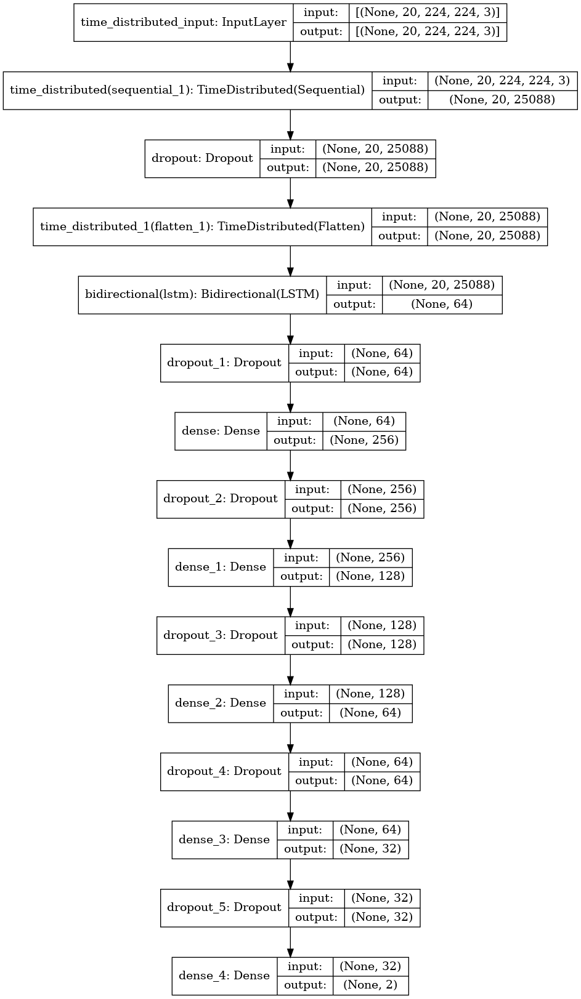

In [23]:
# Plot the structure of the contructed LRCN model.
plot_model(VGG19_model, to_file = 'VGG19_model_structure_plot.png', show_shapes = True, show_layer_names = True)

In [24]:
#restore the best weights
#MoBiLSTM_model.load_weights('ModelWeights.h5')
# Fitting the model 
VGG19_model_history = VGG19_model.fit(train_ds,
                                             validation_data = valid_ds,
                                             steps_per_epoch = steps_per_epoch , 
                                             epochs = EPOCHS, 
                                             batch_size = BS,
                                             #shuffle = True,
                                             #validation_split = 0.2, 
                                             callbacks = [early_stopping_callback,model_checkpoints,reduce_lr])
#model_checkpoints

2023-01-08 14:19:15.439686: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/20


2023-01-08 14:19:22.712358: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


73/73 [==============================] - 326s 4s/step - loss: 0.7122 - accuracy: 0.4879 - f1_score: 0.4850 - val_loss: 0.6815 - val_accuracy: 0.5299 - val_f1_score: 0.3768

Epoch 00001: val_loss improved from inf to 0.68154, saving model to ./ModelWeights.h5
Epoch 2/20
73/73 [==============================] - 328s 4s/step - loss: 0.6847 - accuracy: 0.5732 - f1_score: 0.5730 - val_loss: 0.6853 - val_accuracy: 0.4855 - val_f1_score: 0.3297

Epoch 00002: val_loss did not improve from 0.68154
Epoch 3/20
73/73 [==============================] - 289s 4s/step - loss: 0.6923 - accuracy: 0.5311 - f1_score: 0.5254 - val_loss: 0.6634 - val_accuracy: 0.7231 - val_f1_score: 0.7174

Epoch 00003: val_loss improved from 0.68154 to 0.66343, saving model to ./ModelWeights.h5
Epoch 4/20
73/73 [==============================] - 328s 5s/step - loss: 0.6707 - accuracy: 0.5838 - f1_score: 0.5829 - val_loss: 0.6305 - val_accuracy: 0.7402 - val_f1_score: 0.7390

Epoch 00004: val_loss improved from 0.66343 to 0

In [25]:
#save_locally = tf.saved_model.SaveOptions(experimental_io_device='/job:localhost')
# saving in Tensorflow's "SavedModel" format
VGG19_model.save('VGG19_model.h5', options=save_locally)
model_evaluation_history = VGG19_model.evaluate(test_ds)

31/31 [==============================] - 36s 1s/step - loss: 0.4775 - accuracy: 0.8412 - f1_score: 0.8398


# **Model Evaluation**

In [26]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
    
    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]
    
    # Get the Epochs Count
    epochs = range(len(metric_value_1))
 
    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'orange', label = metric_name_2)
 
    plt.title(str(plot_name))
 
    plt.legend()

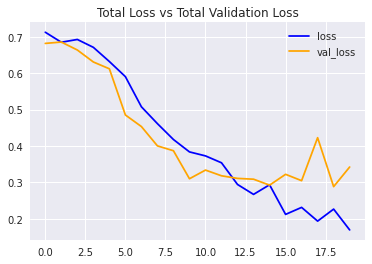

In [27]:
plot_metric(VGG19_model_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

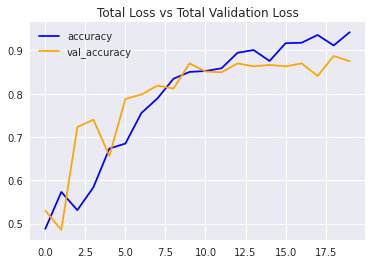

In [28]:
plot_metric(VGG19_model_history, 'accuracy', 'val_accuracy', 'Total Loss vs Total Validation Loss')

# **Predicting the Test Set**

In [29]:
import tensorflow_addons as tfa

f1_score = tfa.metrics.F1Score(average='macro' , num_classes= len(CLASSES))

In [30]:
with strategy.scope():
    load_locally = tf.saved_model.LoadOptions(experimental_io_device='/job:localhost')
    model = tf.keras.models.load_model('./VGG19_model.h5', options=load_locally) # loading in Tensorflow's "SavedModel" format

In [31]:
preds = model.predict(test_ds,verbose=1)
predicted = tf.concat(preds, axis=0)
predicted = tf.argmax(preds, axis=1)
preds = np.argmax(preds, axis=1)

31/31 [==============================] - 28s 876ms/step


In [32]:
predicted

<tf.Tensor: shape=(403,), dtype=int64, numpy=
array([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0,
       1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0,
       0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1,
       0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1,
       1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0,
       0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
     

In [33]:
def get_res2(_gen):
    res = []
    i = 0
    for k, l in _gen:
        res.append(int(l[1]))
        i+=1
        if i == len(preds):
            break
    
    return tf.stack(res, axis=0)     

In [34]:
test_ds2 = test_ds.unbatch().apply(tf.data.experimental.assert_cardinality(len(preds)))

In [35]:
y_test = get_res2(test_ds2)

In [36]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

ROC AUC score: 0.49575622995312113


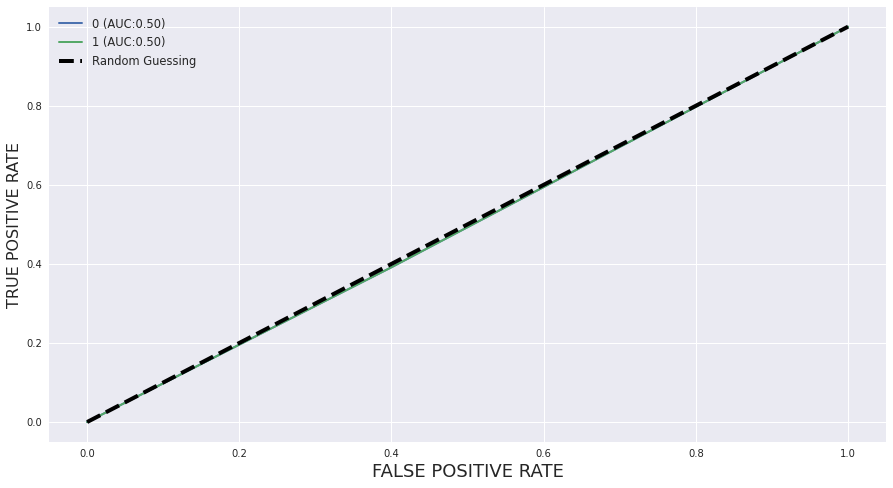

In [37]:
fig, c_ax = plt.subplots(1,1, figsize = (15,8))

def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    for (idx, c_label) in enumerate([0,1]):
        fpr, tpr, thresholds = roc_curve(y_test, preds)
        c_ax.plot(fpr, tpr,lw=2, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
    c_ax.plot(fpr, fpr, 'black',linestyle='dashed', lw=4, label = 'Random Guessing')
    return roc_auc_score(y_test, y_pred, average=average)

print('ROC AUC score:', multiclass_roc_auc_score(y_test , preds  , average = "micro"))
plt.xlabel('FALSE POSITIVE RATE', fontsize=18)
plt.ylabel('TRUE POSITIVE RATE', fontsize=16)
plt.legend(fontsize = 11.5)
plt.show()

Accuracy Score

In [38]:
from sklearn.metrics import accuracy_score
AccScore = accuracy_score(predicted, y_test)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.4913151364764268


Confusion Matrix

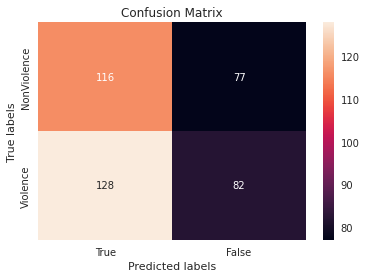

In [39]:
import seaborn as sns 
from sklearn.metrics import confusion_matrix

ax= plt.subplot()
cm=confusion_matrix(y_test, preds)
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  

ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['True', 'False']); ax.yaxis.set_ticklabels(CLASSES);

Classification Report

# **Prediction Frame By Frame**

In [48]:
from collections import deque

In [49]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):
    
    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'), 
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
 
    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)
 
    # Store the predicted class in the video.
    predicted_class_name = ''
 
    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():
 
        ok, frame = video_reader.read() 
        
        if not ok:
            break
 
        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame 
        normalized_frame = resized_frame / 255
 
        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)
 
        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:                        
 
            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = model.predict(np.expand_dims(frames_queue, axis = 0))[0]
 
            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)
 
            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES[predicted_label]
 
        # Write predicted class name on top of the frame.
        if predicted_class_name == "Violence":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)
         
        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)                       
        
    video_reader.release()
    video_writer.release()

In [50]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path): 

    plt.figure(figsize=(20,15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Get Random Frames from the video then Sort it
    random_range = sorted(random.sample(range (Frame , frames_count ), 12))
        
    for counter, random_index in enumerate(random_range, 1):
        
        plt.subplot(5, 4, counter)

        # Set the current frame position of the video.  
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)
          
        ok, frame = video_reader.read() 

        if not ok:
          break 

        frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

        plt.imshow(frame);ax.figure.set_size_inches(20,20);plt.tight_layout()
                            
    video_reader.release()

In [51]:
# Construct the output video path.
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)
 
output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

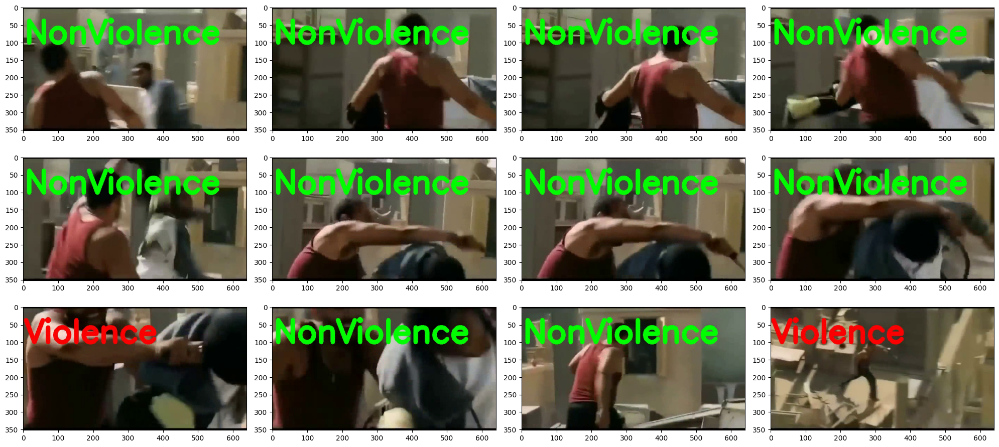

In [52]:
# Specifying video to be predicted
input_video_file_path = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/Violence/V_378.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, Frame)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [53]:
# Play the actual video
Play_Video(input_video_file_path)

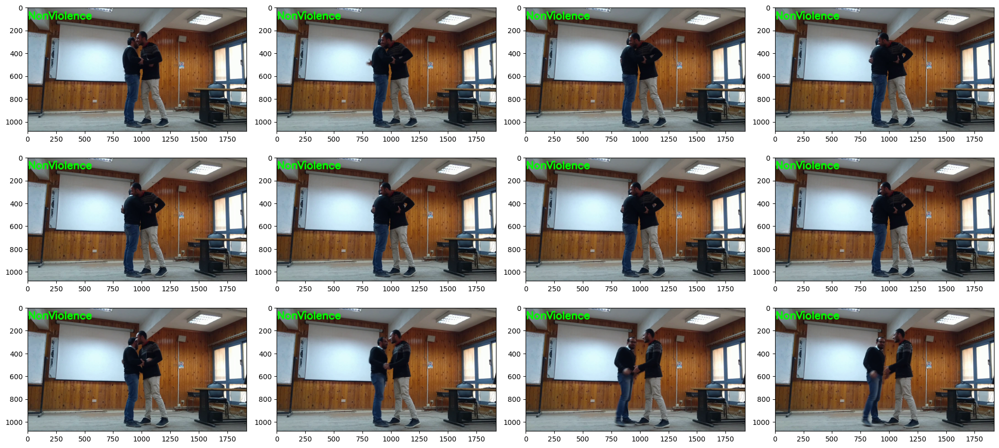

In [54]:
# Specifying video to be predicted
input_video_file_path = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/NonViolence/NV_1.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, Frame)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [55]:
# Play the actual video
Play_Video(input_video_file_path)

# **Prediction For The Video**

In [56]:
def predict_video(video_file_path, SEQUENCE_LENGTH):
 
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # Declare a list to store video frames we will extract.
    frames_list = []
    
    # Store the predicted class in the video.
    predicted_class_name = ''
 
    # Get the number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
 
    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)
 
    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):
 
        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
 
        success, frame = video_reader.read() 
 
        if not success:
            break
 
        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame.
        normalized_frame = resized_frame / 255
        
        # Appending the pre-processed frame into the frames list
        frames_list.append(normalized_frame)
 
    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = model.predict(np.expand_dims(frames_list, axis = 0))[0]
 
    # Get the index of class with highest probability.
    predicted_label = np.argmax(predicted_labels_probabilities)
 
    # Get the class name using the retrieved index.
    predicted_class_name = CLASSES[predicted_label]
    
    # Display the predicted class along with the prediction confidence.
    print(f'Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')
        
    video_reader.release()

In [57]:
# Specifying video to be predicted
input_video_file_path = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/Violence/V_276.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, Frame)

# Play the actual video
Play_Video(input_video_file_path)

Predicted: Violence
Confidence: 0.9654462337493896


In [58]:
# Specifying video to be predicted
input_video_file_path = "../input/real-life-violence-situations-dataset/Real Life Violence Dataset/NonViolence/NV_23.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, Frame)

# Play the actual video
Play_Video(input_video_file_path)

Predicted: NonViolence
Confidence: 0.9752110838890076
